<a href="https://colab.research.google.com/github/aln21-ua/TFM-PINNs/blob/main/Implementacion/Ecuacion%20de%20onda/Comparativa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Librerías

In [ ]:
# Cálculo numérico
import numpy as np

# Representación y animación
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Visualización de la animación en Colab
from IPython.display import HTML

# Guardar archivos en drive
mountdrive = True
if mountdrive==True:
  from google.colab import drive
  drive.mount('/content/drive')

Mounted at /content/drive


# Info

In [ ]:
# Longitud de la cuerda
L = 1.0

# Tiempo máximo de simulación
T = 10.0

# Discretización espacial y temporal
Nx = 51  # Número de puntos espaciales
Nt = 61  # Número de puntos temporales
x = np.linspace(0, L, Nx)
t = np.linspace(0, T, Nt)

A=1

# Cargar datos

In [ ]:
TFM_route = "/content/drive/MyDrive/TFM/Implementacion/"
simulation_name = "Ecuacion de onda amortiguada/"

if mountdrive == True:
  TFM_route = "/content/drive/MyDrive/TFM/Implementacion/"
  simulation_name = "Ecuacion de onda amortiguada/Matrices/"
  u_tx_real = np.load(TFM_route+simulation_name+"u_tx_real.npy")
  u_tx_PINN = np.load(TFM_route+simulation_name+"u_tx_PINN-.npy")
  u_tx_PINN_Datos = np.load(TFM_route+simulation_name+"u_tx_PINN_datos-.npy")
  u_tx_NN_Datos = np.load(TFM_route+simulation_name+"u_tx_NN_datos-.npy")
  u_tx_PINNsFormer = np.load(TFM_route+simulation_name+"u_tx_PINNsFormer-.npy")
  u_tx_PINNsFormer_Datos = np.load(TFM_route+simulation_name+"u_tx_PINNsFormer_datos-.npy")
  u_tx_Transformer_Datos = np.load(TFM_route+simulation_name+"u_tx_Transformer_datos-.npy")
else:
  u_tx_real = np.load("u_tx_real.npy")
  u_tx_PINN = np.load("u_tx_PINN-.npy")
  u_tx_PINN_Datos = np.load("u_tx_PINN_datos-.npy")
  u_tx_NN_Datos = np.load("u_tx_NN_datos-.npy")
  u_tx_PINNsFormer = np.load("u_tx_PINNsFormer-.npy")
  u_tx_PINNsFormer_Datos = np.load("u_tx_PINNsFormer_datos-.npy")
  u_tx_Transformer_Datos = np.load("u_tx_Transformer_datos-.npy")



## Error absoluto

In [ ]:
def AE(u_tx):
  return np.abs(u_tx_real-u_tx)

# Significancia estadistica

In [ ]:
print(u_tx_PINN.shape, u_tx_PINN_Datos.shape,u_tx_NN_Datos.shape,u_tx_PINNsFormer.shape,u_tx_PINNsFormer_Datos.shape,u_tx_Transformer_Datos.shape)

(5, 61, 51) (5, 61, 51) (5, 61, 51) (5, 61, 51) (5, 61, 51) (5, 61, 51)


## MAE de cada simulación

In [ ]:
def MAE_list(u_tx_list):
  lista = []
  for u_tx in u_tx_list:
    lista.append(np.mean(AE(u_tx)))
  return lista

In [ ]:
MAE_dict = {
            'PINN': MAE_list(u_tx_PINN),
            'PINN_Datos': MAE_list(u_tx_PINN_Datos),
            'NN_Datos': MAE_list(u_tx_NN_Datos),
            'PINNsFormer': MAE_list(u_tx_PINNsFormer),
            'PINNsFormer_Datos': MAE_list(u_tx_PINNsFormer_Datos),
            'Transformer_Datos': MAE_list(u_tx_Transformer_Datos)
            }
MAE_dict

{'PINN': [0.012675831989080576,
  0.02992473787439293,
  0.012663559584857719,
  0.02810971237850869,
  0.00591031648705945],
 'PINN_Datos': [0.004619434235033733,
  0.005385923698764686,
  0.010126229913430018,
  0.0033233822705763865,
  0.004351601088744574],
 'NN_Datos': [0.09356330978836466,
  0.4702960162564169,
  0.06433746143297217,
  0.21339079671933864,
  0.21100135237648898],
 'PINNsFormer': [0.007066997669253426,
  0.006094657439086114,
  0.005997687832402156,
  0.006603866290854661,
  0.008120537171985099],
 'PINNsFormer_Datos': [0.003649350920107171,
  0.003867816515125719,
  0.003701622045641483,
  0.0036828007434098614,
  0.003521228538977066],
 'Transformer_Datos': [0.005686061001504325,
  0.005455050292619467,
  0.006364899516089297,
  0.005374699468590285,
  0.004199846669226562]}

In [ ]:
print("##### MAE MEDIO #####")
MAE_medio = {}
for model in MAE_dict:
  MAE_medio[model] = round(np.mean(np.array(MAE_dict[model])),3)

MAE_medio

##### MAE MEDIO #####


{'PINN': 0.018,
 'PINN_Datos': 0.006,
 'NN_Datos': 0.211,
 'PINNsFormer': 0.007,
 'PINNsFormer_Datos': 0.004,
 'Transformer_Datos': 0.005}

## MAE de la solución media

In [ ]:
def MAE_sol(u_tx_list):
  return round(np.mean(AE(np.mean(u_tx_list, axis=0))),4)


In [ ]:
MAE_sol_media = {'PINN': MAE_sol(u_tx_PINN),
                 'PINN_Datos': MAE_sol(u_tx_PINN_Datos),
                 'NN_Datos': MAE_sol(u_tx_NN_Datos),
                 'PINNsFormer': MAE_sol(u_tx_PINNsFormer),
                 'PINNsFormer_Datos': MAE_sol(u_tx_PINNsFormer_Datos),
                 'Transformer_Datos': MAE_sol(u_tx_Transformer_Datos)
                 }
print("##### MAE de la solución media #####")
MAE_sol_media

##### MAE de la solución media #####


{'PINN': 0.0145,
 'PINN_Datos': 0.0047,
 'NN_Datos': 0.1552,
 'PINNsFormer': 0.0066,
 'PINNsFormer_Datos': 0.0036,
 'Transformer_Datos': 0.0045}

## $\sigma$ del AE la solución media

In [ ]:
def std_AE_sol(u_tx_list):
  return round(np.std(AE(np.mean(u_tx_list, axis=0))),3)


In [ ]:
std_AE_sol_media = {'PINN': std_AE_sol(u_tx_PINN),
                 'PINN_Datos': std_AE_sol(u_tx_PINN_Datos),
                 'NN_Datos': std_AE_sol(u_tx_NN_Datos),
                 'PINNsFormer': std_AE_sol(u_tx_PINNsFormer),
                 'PINNsFormer_Datos': std_AE_sol(u_tx_PINNsFormer_Datos),
                 'Transformer_Datos': std_AE_sol(u_tx_Transformer_Datos)
                 }
print("##### STD del error absoluto de la solución media #####")
std_AE_sol_media

##### STD del error absoluto de la solución media #####


{'PINN': 0.013,
 'PINN_Datos': 0.004,
 'NN_Datos': 0.663,
 'PINNsFormer': 0.009,
 'PINNsFormer_Datos': 0.007,
 'Transformer_Datos': 0.017}

## $E_\max$ del AE la solución media

In [ ]:
def Emax_AE_sol(u_tx_list):
  return round(np.max(AE(np.mean(u_tx_list, axis=0))),2)


In [ ]:
Emax_AE_sol_media = {'PINN': Emax_AE_sol(u_tx_PINN),
                 'PINN_Datos': Emax_AE_sol(u_tx_PINN_Datos),
                 'NN_Datos': Emax_AE_sol(u_tx_NN_Datos),
                 'PINNsFormer': Emax_AE_sol(u_tx_PINNsFormer),
                 'PINNsFormer_Datos': Emax_AE_sol(u_tx_PINNsFormer_Datos),
                 'Transformer_Datos': Emax_AE_sol(u_tx_Transformer_Datos)
                 }
print("##### Maximo del error absoluto de la solución media #####")
Emax_AE_sol_media

##### Maximo del error absoluto de la solución media #####


{'PINN': 0.06,
 'PINN_Datos': 0.02,
 'NN_Datos': 5.72,
 'PINNsFormer': 0.06,
 'PINNsFormer_Datos': 0.05,
 'Transformer_Datos': 0.33}

In [ ]:
print("Modelo   MAE medio   MAE sol media   std AE sol media    AEmax sol media")
for model in MAE_dict:
  print(f"{model}   {MAE_medio[model]}    {MAE_sol_media[model]}   {std_AE_sol_media[model]}    {Emax_AE_sol_media[model]}")

Modelo   MAE medio   MAE sol media   std AE sol media    AEmax sol media
PINN   0.018    0.0145   0.013    0.06
PINN_Datos   0.006    0.0047   0.004    0.02
NN_Datos   0.211    0.1552   0.663    5.72
PINNsFormer   0.007    0.0066   0.009    0.06
PINNsFormer_Datos   0.004    0.0036   0.007    0.05
Transformer_Datos   0.005    0.0045   0.017    0.33


## Test ANOVA

In [ ]:
import scipy.stats as stats

stats.f_oneway(*tuple(MAE_dict.values()))

F_onewayResult(statistic=8.003453109385354, pvalue=0.00014792406358131552)

## Test t de Student

In [ ]:
comparedict = {}
for i in range(len(MAE_dict.keys())-1):
  comparedict[list(MAE_dict.keys())[i]] = list(MAE_dict.keys())[i+1:]
comparedict

{'PINN': ['PINN_Datos',
  'NN_Datos',
  'PINNsFormer',
  'PINNsFormer_Datos',
  'Transformer_Datos'],
 'PINN_Datos': ['NN_Datos',
  'PINNsFormer',
  'PINNsFormer_Datos',
  'Transformer_Datos'],
 'NN_Datos': ['PINNsFormer', 'PINNsFormer_Datos', 'Transformer_Datos'],
 'PINNsFormer': ['PINNsFormer_Datos', 'Transformer_Datos'],
 'PINNsFormer_Datos': ['Transformer_Datos']}

In [ ]:


for model1 in comparedict:
  for model2 in comparedict[model1]:
    t_stat, p_value = stats.ttest_ind(MAE_dict[model1], MAE_dict[model2])
    ojo =''
    if p_value>=0.05:
      ojo = ""
    print(ojo+f"{model1} vs. {model2} --- p-value: {round(p_value,4)}")#, t-statistic: {t_stat}")

PINN vs. PINN_Datos --- p-value: 0.0357
PINN vs. NN_Datos --- p-value: 0.0277
PINN vs. PINNsFormer --- p-value: 0.0478
PINN vs. PINNsFormer_Datos --- p-value: 0.0172
PINN vs. Transformer_Datos --- p-value: 0.0305
PINN_Datos vs. NN_Datos --- p-value: 0.0211
! PINN_Datos vs. PINNsFormer --- p-value: 0.3591
! PINN_Datos vs. PINNsFormer_Datos --- p-value: 0.1532
! PINN_Datos vs. Transformer_Datos --- p-value: 0.9096
NN_Datos vs. PINNsFormer --- p-value: 0.0216
NN_Datos vs. PINNsFormer_Datos --- p-value: 0.0202
NN_Datos vs. Transformer_Datos --- p-value: 0.021
PINNsFormer vs. PINNsFormer_Datos --- p-value: 0.0
PINNsFormer vs. Transformer_Datos --- p-value: 0.0313
PINNsFormer_Datos vs. Transformer_Datos --- p-value: 0.0012


# Cálculos de comparativas

## Mapa de calor

In [ ]:
size = 20
def ErrorHeatMap(u_tx, title):
  error_abs_tx = AE(u_tx)
  rMAE = np.sum(error_abs_tx) / np.sum(np.abs(u_tx_real))
  rRMSE = np.sqrt(np.sum(error_abs_tx**2) / np.sum(u_tx_real**2))
  print("rMAE = {:.3f}".format(rMAE))
  print("rRMSE = {:.3f}".format(rRMSE))
  print("Emax = {:.3f}".format(np.max(error_abs_tx)))
  plt.figure(figsize=(6, 2))
  plt.imshow(error_abs_tx[:,::-1].T, extent=[np.min(t), np.max(t), np.min(x), np.max(x)], aspect='auto', interpolation='nearest', cmap = "inferno", vmin=0, vmax = 0.06)#min([np.max(error_abs_tx), 0.06]))
  cbar = plt.colorbar(label='AE(x,t)')
  cbar.ax.tick_params(labelsize=size)
  cbar.set_label('AE(x,t)', fontsize=size)
  cbar.set_ticks(np.linspace(0,0.06,7))
  plt.xlabel('t', fontsize=size)
  plt.ylabel('x', fontsize=size)
  plt.ylim([0,L])
  plt.xticks(np.linspace(0,10,11), fontsize=size)
  plt.yticks(np.linspace(0,1,5),fontsize=size)
  plt.title('Error: '+ title, fontsize=size)
  plt.show()

In [ ]:
def HeatMap(u_tx, title):
  #print("rMAE = {:.3f}".format(rMAE))
  #print("rRMSE = {:.3f}".format(rRMSE))
  plt.figure(figsize=(6, 2))
  plt.imshow(u_tx[:,::-1].T, extent=[np.min(t), np.max(t), np.min(x), np.max(x)], aspect='auto', interpolation='nearest', cmap = "inferno", vmin=-1, vmax=1)
  cbar = plt.colorbar(label='u(x,t)')
  cbar.ax.tick_params(labelsize=size)
  cbar.set_label('u(x,t)', fontsize=size)
  cbar.set_ticks(np.linspace(-1,1,5))
  plt.xlabel('t', fontsize=size)
  plt.ylabel('x', fontsize=size)
  plt.ylim([0,L])
  plt.xticks(np.linspace(0,10,11), fontsize=size)
  plt.yticks(np.linspace(0,1,5),fontsize=size)
  plt.title(title, fontsize=size)
  plt.show()

## Animación

In [ ]:
def AnimComparacion(u_tx, title):
  fig, ax = plt.subplots()
  ax.set_xlim(0, L)
  #ax.set_ylim(-A*1.1, A*1.1)
  #ax.set_ylim(-0.25, 0.25)
  ax.set_xlabel('x', fontsize=size)
  ax.set_ylabel('u(x,t)', fontsize=size)
  ax.set_title("Analítica vs. "+title, fontsize=size)

  # Imagen inicial
  line_real, = ax.plot(x, u_tx_real[0], label="Solución analítica")
  line, = ax.plot(x, u_tx[0], color="tab:purple", label = title)
  tiempo_text = ax.text(0.95, 0.95, '', transform=ax.transAxes, ha='right', va='top', fontsize=size)
  legend = ax.legend(loc="lower left", fontsize=size)

  def actualizar(frame):
    line_real.set_ydata(u_tx_real[frame])
    lim = np.max(np.abs(u_tx[frame]))*1.1
    ax.set_ylim(-lim,lim)
    line.set_ydata(u_tx[frame])
    tiempo_text.set_text(f't: {t[frame]:.2f}')
    return line_real, line, tiempo_text, legend

  # Actualizar
  ani = animation.FuncAnimation(fig, actualizar, frames=Nt, interval=50, blit=True)

  # Mostrar la animación en Google Colab
  plt.close("all")
  return HTML(ani.to_jshtml())

# Análisis de los resultados

## Mapa de calor

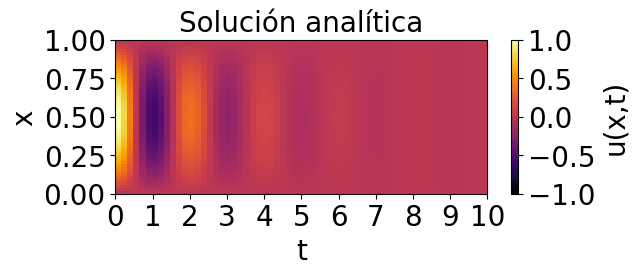

In [ ]:
HeatMap(u_tx_real, "Solución analítica")

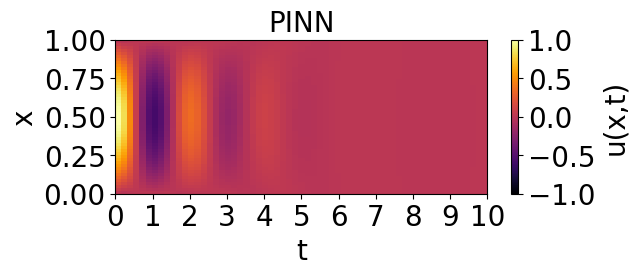

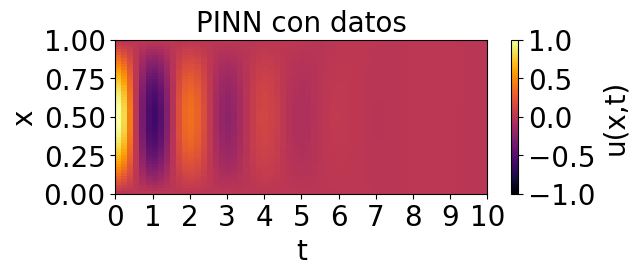

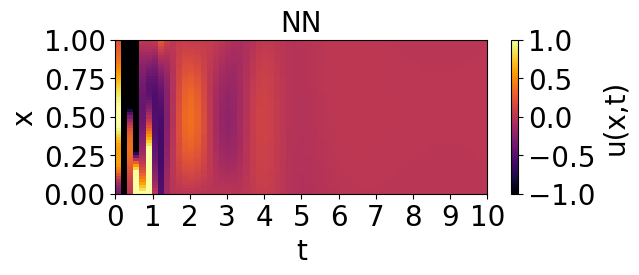

In [ ]:
HeatMap(np.mean(u_tx_PINN, axis = 0), "PINN")
HeatMap(np.mean(u_tx_PINN_Datos, axis = 0), "PINN con datos")
HeatMap(np.mean(u_tx_NN_Datos, axis = 0), "NN")

rMAE = 0.176
rRMSE = 0.113
Emax = 0.056


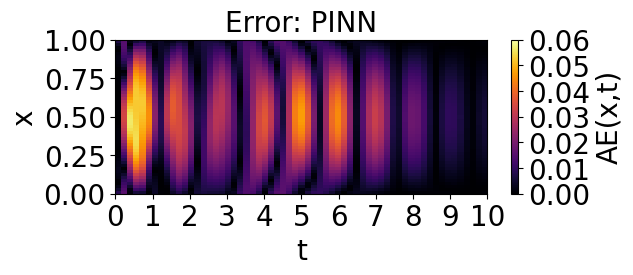

rMAE = 0.057
rRMSE = 0.038
Emax = 0.021


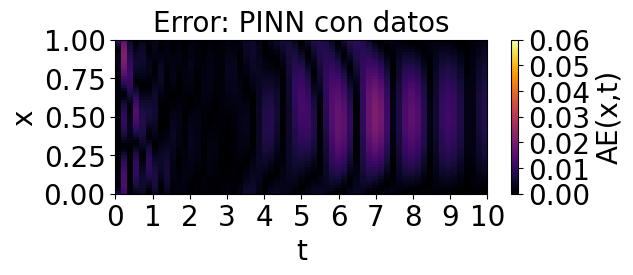

rMAE = 1.881
rRMSE = 4.007
Emax = 5.722


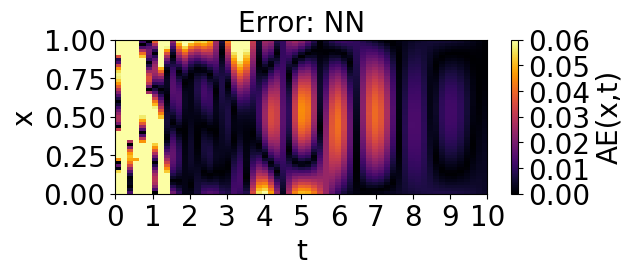

In [ ]:
ErrorHeatMap(np.mean(u_tx_PINN, axis = 0), "PINN")
ErrorHeatMap(np.mean(u_tx_PINN_Datos, axis = 0), "PINN con datos")
ErrorHeatMap(np.mean(u_tx_NN_Datos, axis = 0), "NN")

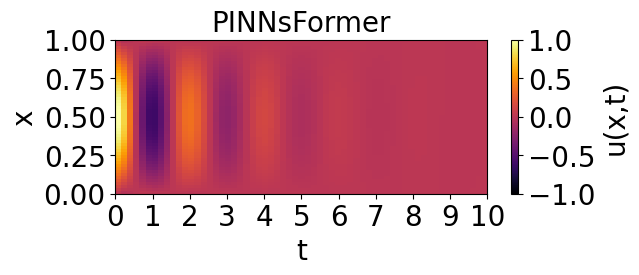

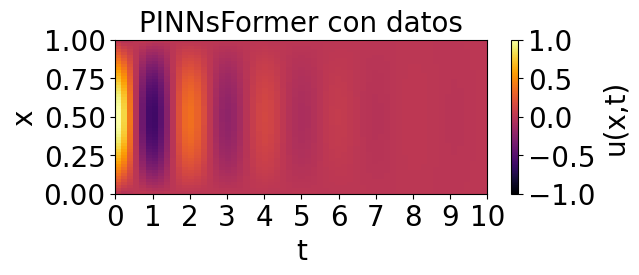

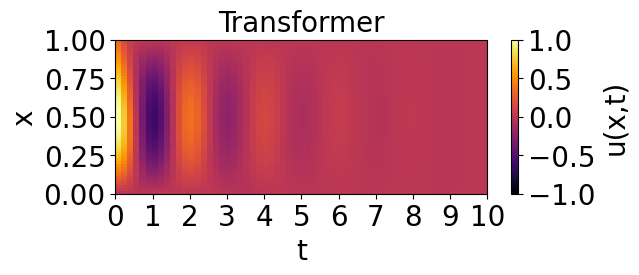

In [ ]:
HeatMap(np.mean(u_tx_PINNsFormer, axis = 0), "PINNsFormer")
HeatMap(np.mean(u_tx_PINNsFormer_Datos, axis = 0), "PINNsFormer con datos")
HeatMap(np.mean(u_tx_Transformer_Datos, axis = 0), "Transformer")

rMAE = 0.080
rRMSE = 0.067
Emax = 0.058


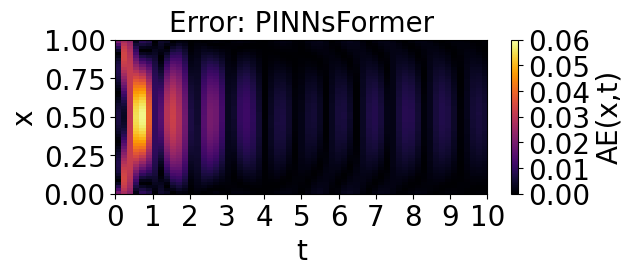

rMAE = 0.043
rRMSE = 0.048
Emax = 0.051


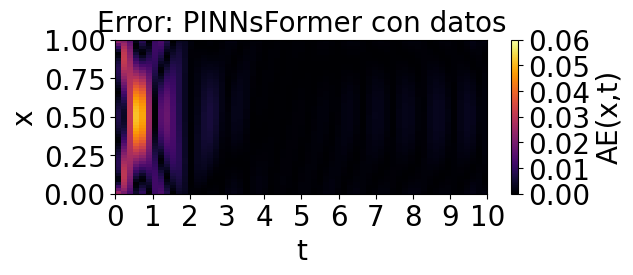

rMAE = 0.054
rRMSE = 0.102
Emax = 0.329


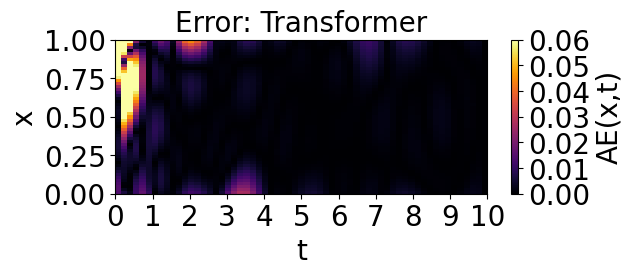

In [ ]:
ErrorHeatMap(np.mean(u_tx_PINNsFormer, axis = 0), "PINNsFormer")
ErrorHeatMap(np.mean(u_tx_PINNsFormer_Datos, axis = 0), "PINNsFormer con datos")
ErrorHeatMap(np.mean(u_tx_Transformer_Datos, axis = 0), "Transformer")

## Animación

In [ ]:
size=25
fig, ax = plt.subplots()
ax.set_xlim(0, L)
ax.set_ylim(-A*1.1, A*1.1)
ax.set_xlabel('x', fontsize=size)
ax.set_ylabel('u(x,t)', fontsize=size)
ax.set_title("Onda amortiguada", fontsize=size)
ax.tick_params(axis='both', which='major', labelsize=size)

# Imagen inicial
line_real, = ax.plot(x, u_tx_real[0])
tiempo_text = ax.text(0.95, 0.95, '', transform=ax.transAxes, ha='right', va='top', fontsize=size)

def actualizar(frame):
  line_real.set_ydata(u_tx_real[frame])
  tiempo_text.set_text(f't: {t[frame]:.1f}')
  return line_real, tiempo_text,

# Actualizar
ani = animation.FuncAnimation(fig, actualizar, frames=Nt, interval=50, blit=True)

# Mostrar la animación en Google Colab
plt.close("all")
HTML(ani.to_jshtml())

In [ ]:
AnimComparacion(np.mean(u_tx_PINN, axis = 0), "PINN")

In [ ]:
AnimComparacion(np.mean(u_tx_PINN_Datos, axis = 0), "PINN con datos")

In [ ]:
AnimComparacion(np.mean(u_tx_NN_Datos, axis = 0), "NN")

In [ ]:
AnimComparacion(np.mean(u_tx_PINNsFormer, axis = 0), "PINNsFormer")

In [ ]:
AnimComparacion(np.mean(u_tx_PINNsFormer_Datos, axis = 0), "PINNsFormer con datos")

In [ ]:
AnimComparacion(np.mean(u_tx_Transformer_Datos, axis = 0), "Transformer")